In [1]:
import scanpy as sc
import numpy as np
import scipy as sp
import pandas as pd
import matplotlib.pyplot as plt
from matplotlib import rcParams
from matplotlib import colors
import seaborn as sb
from gprofiler import gprofiler
import logging,matplotlib,os,sys

from rpy2.robjects import pandas2ri

pandas2ri.activate()
# anndata2ri.activate()
%load_ext rpy2.ipython

plt.rcParams['figure.figsize']=(6,6) #rescale figures
sc.settings.verbosity = 3
sc.set_figure_params(dpi=300, dpi_save=300)
sc.logging.print_versions()

matplotlib.rcParams['pdf.fonttype']=42
matplotlib.rcParams['font.size']=10

os.getcwd()
os.chdir('/public/home/jphe/ATACseq/mm10/sc/E-MTAB-6714/bt2/scTE/scTE/scanpy/cellLines')
os.getcwd()

/public/home/jphe/anaconda3/envs/scanpy/lib/python3.6/site-packages/dask/config.py:168: YAMLLoadWarning: calling yaml.load() without Loader=... is deprecated, as the default Loader is unsafe. Please read https://msg.pyyaml.org/load for full details.
  data = yaml.load(f.read()) or {}


scanpy==1.4.4 anndata==0.6.22.post1 umap==0.3.10 numpy==1.16.4 scipy==1.3.1 pandas==0.25.0 scikit-learn==0.19.2 statsmodels==0.10.1 python-igraph==0.7.1 louvain==0.6.1


'/public/home/jphe/ATACseq/mm10/sc/E-MTAB-6714/bt2/scTE/scTE/scanpy/cellLines'

In [2]:
import glob, os, sys

adata = sc.read('../../c1_mESC.csv',cache=False)
sc.pp.filter_cells(adata, min_genes = 500)
adata.obs['time'] ='c1_mESC'

for f in sorted(glob.glob('../../*csv')):
    head = os.path.split(f)[1].replace('.csv','')
    if head == 'c1_mESC' or head == 'mSp':
        continue
    print(head)
    tmp = sc.read(f, cache = False)
    sc.pp.filter_cells(tmp, min_genes = 5)
    
    tmp.obs['time'] = head
    adata = adata.concatenate([tmp])

adata

--> This might be very slow. Consider passing `cache=True`, which enables much faster reading from a cache file.
filtered out 7 cells that haveless than 500 genes expressed
cd4_sorttag
--> This might be very slow. Consider passing `cache=True`, which enables much faster reading from a cache file.
cd4_tagsort
--> This might be very slow. Consider passing `cache=True`, which enables much faster reading from a cache file.
mCPC_E8.5
--> This might be very slow. Consider passing `cache=True`, which enables much faster reading from a cache file.
mCPC_E9.5
--> This might be very slow. Consider passing `cache=True`, which enables much faster reading from a cache file.
mSF
--> This might be very slow. Consider passing `cache=True`, which enables much faster reading from a cache file.
plate_mESC
--> This might be very slow. Consider passing `cache=True`, which enables much faster reading from a cache file.


AnnData object with n_obs × n_vars = 2231 × 1081 
    obs: 'batch', 'n_genes', 'time'

In [3]:
adata.obs.index = [ k.split('-')[0] for k in adata.obs.index ]
adata.obs.head(5)

,batch,n_genes,time
c1_mESC_chip1_01,0,749,c1_mESC
c1_mESC_chip1_02,0,912,c1_mESC
c1_mESC_chip1_03,0,756,c1_mESC
c1_mESC_chip1_04,0,765,c1_mESC
c1_mESC_chip1_05,0,647,c1_mESC


In [4]:
sc.pp.filter_genes(adata, min_cells=10)
print('Number of genes after cell filter: {:d}'.format(adata.n_vars))
adata

filtered out 4 genes that are detectedin less than 10 cells
Number of genes after cell filter: 1077


AnnData object with n_obs × n_vars = 2231 × 1077 
    obs: 'batch', 'n_genes', 'time'
    var: 'n_cells'

In [5]:
adata.X = adata.X.astype('float64')
adata.obs['time'].value_counts()

mCPC_E9.5      382
mSF            380
cd4_sorttag    371
mCPC_E8.5      362
cd4_tagsort    361
plate_mESC     192
c1_mESC        183
Name: time, dtype: int64

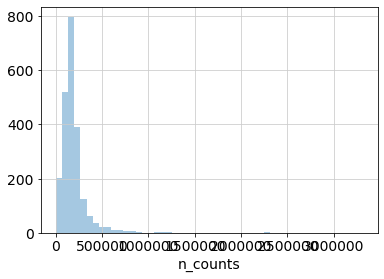

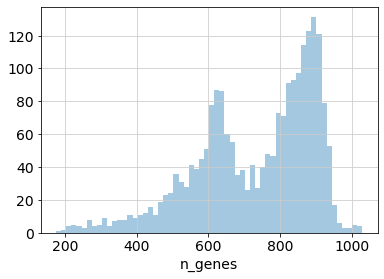

In [6]:
adata.obs['n_counts'] = adata.X.sum(1)
adata.obs['log_counts'] = np.log(adata.obs['n_counts'])
adata.obs['n_genes'] = (adata.X > 0).sum(1)

#Thresholding decision: counts
p3 = sb.distplot(adata.obs['n_counts'], kde=False)
plt.show()

#Thresholding decision: genes
p6 = sb.distplot(adata.obs['n_genes'], kde=False, bins=60)
plt.show()


... storing 'time' as categorical


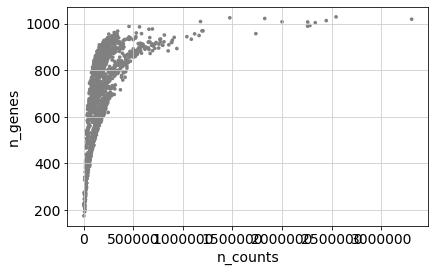

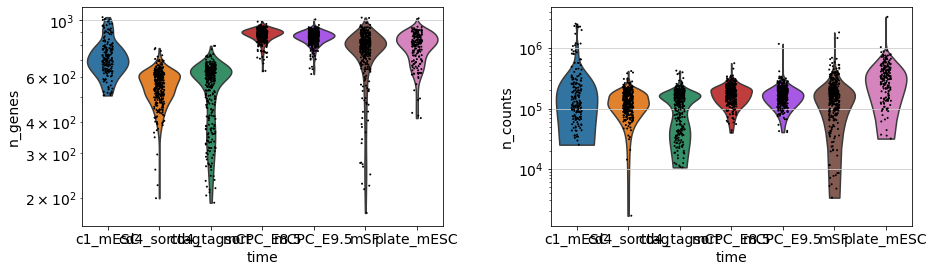

In [7]:
p1 = sc.pl.scatter(adata, 'n_counts', 'n_genes')
p2 = sc.pl.violin(adata, ['n_genes','n_counts'], groupby='time', size=2, log=True, cut=0)

In [8]:
sc.pp.filter_cells(adata, max_counts = 1e6)

filtered out 18 cells that havemore than 1000000.0 counts


In [9]:
adata.raw=adata

In [10]:
from __future__ import division
import glob,os

size_factors = {}
for f in glob.glob('../../../../*/zzresults.tsv'):
    head = os.path.split(f)[0]
    if 'mSp' in head:
            continue
    print(head)
    
    o = open(f,'rU')
    for l in o:
        if 'Sample' in l:
            continue
        l=l.strip().split('\t')
        sample=l[0].replace('mouse_skin_fibr','mSF')
        nf=int(l[1])/1e6
        
        size_factors[sample]=nf

../../../../cd4_sorttag
../../../../cd4_tagsort
../../../../mCPC_E8.5
../../../../c1_mESC
../../../../mCPC_E9.5


/public/home/jphe/anaconda3/envs/scanpy/lib/python3.6/site-packages/ipykernel_launcher.py:11: DeprecationWarning: 'U' mode is deprecated
  # This is added back by InteractiveShellApp.init_path()


../../../../mouse_skin_fibr
../../../../plate_mESC


In [11]:
size = [size_factors[k] for k in adata.obs.index ]

In [12]:
adata.X=adata.raw.X

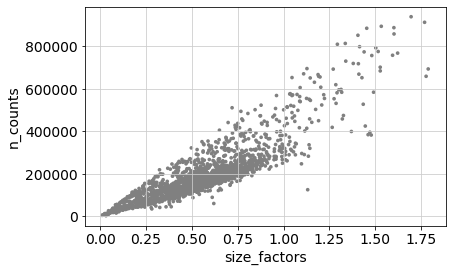

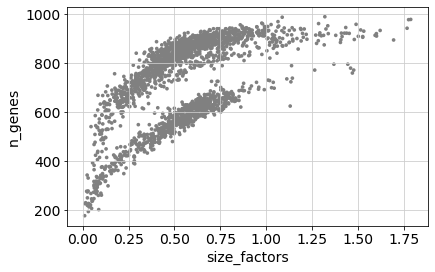

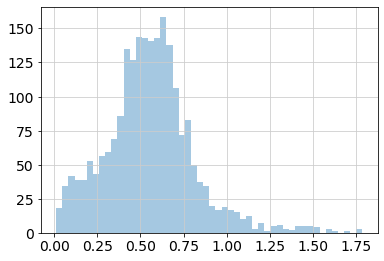

In [13]:
adata.obs['size_factors'] = size

sc.pl.scatter(adata, 'size_factors', 'n_counts')
sc.pl.scatter(adata, 'size_factors', 'n_genes')

sb.distplot(size, bins=50, kde=False)
plt.show()

#Keep the count data in a counts layer
adata.layers["counts"] = adata.X.copy()

#Normalize adata 
adata.X /= adata.obs['size_factors'].values[:,None]
sc.pp.log1p(adata)

# Store the full data set in 'raw' as log-normalised data for statistical testing
adata.raw = adata

extracting highly variable genes
    finished (0:00:00)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)

 Number of highly variable genes: 89


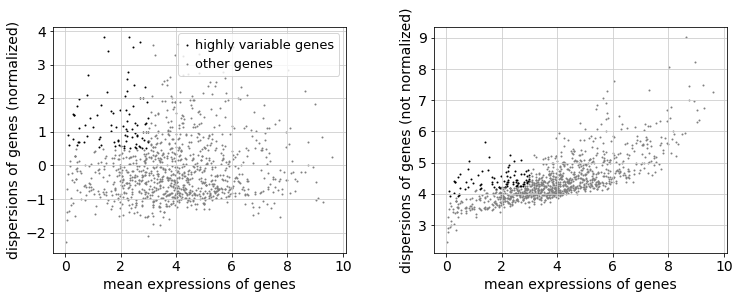

computing PCA with n_comps = 20
computing PCA on highly variable genes
    finished (0:00:00)
computing neighbors
    using 'X_pca' with n_pcs = 20
    finished (0:00:01)
computing tSNE
    using 'X_pca' with n_pcs = 20
    using the 'MulticoreTSNE' package by Ulyanov (2017)
    finished (0:00:05)
computing UMAP
    finished (0:00:06)
computing Diffusion Maps using n_comps=15(=n_dcs)
computing transitions
    finished (0:00:00)
    eigenvalues of transition matrix
    [1.         0.9543285  0.84841967 0.83425915 0.8103686  0.7936475
     0.78682995 0.7652888  0.75949395 0.75180703 0.7438539  0.73248094
     0.723756   0.7185682  0.7148266 ]
    finished (0:00:00)


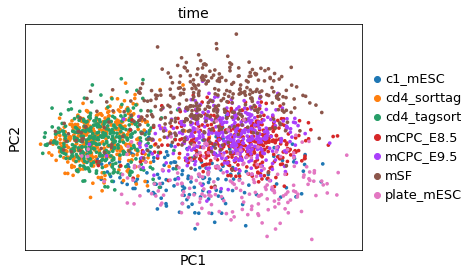

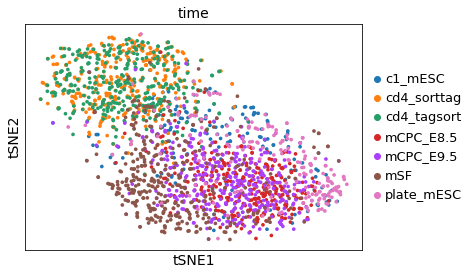

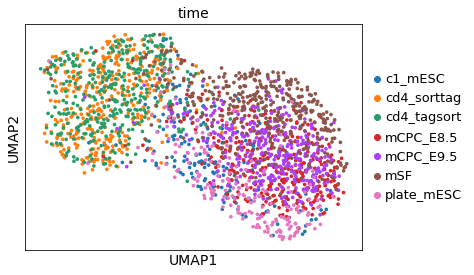

In [14]:
sc.pp.highly_variable_genes(adata, flavor='seurat')
print('\n','Number of highly variable genes: {:d}'.format(np.sum(adata.var['highly_variable'])))
sc.pl.highly_variable_genes(adata)

sc.pp.pca(adata, n_comps=20, use_highly_variable=True, svd_solver='arpack')
sc.pp.neighbors(adata)

sc.tl.tsne(adata, n_jobs=20)
sc.tl.umap(adata)
sc.tl.diffmap(adata)

sc.pl.pca(adata,color=['time'])
sc.pl.tsne(adata,color=['time'])
sc.pl.umap(adata,color=['time'])

computing PCA with n_comps = 20
    finished (0:00:00)
computing neighbors
    using 'X_pca' with n_pcs = 20
    finished (0:00:00)
computing tSNE
    using 'X_pca' with n_pcs = 20
    using the 'MulticoreTSNE' package by Ulyanov (2017)
    finished (0:00:04)
computing UMAP
    finished (0:00:06)


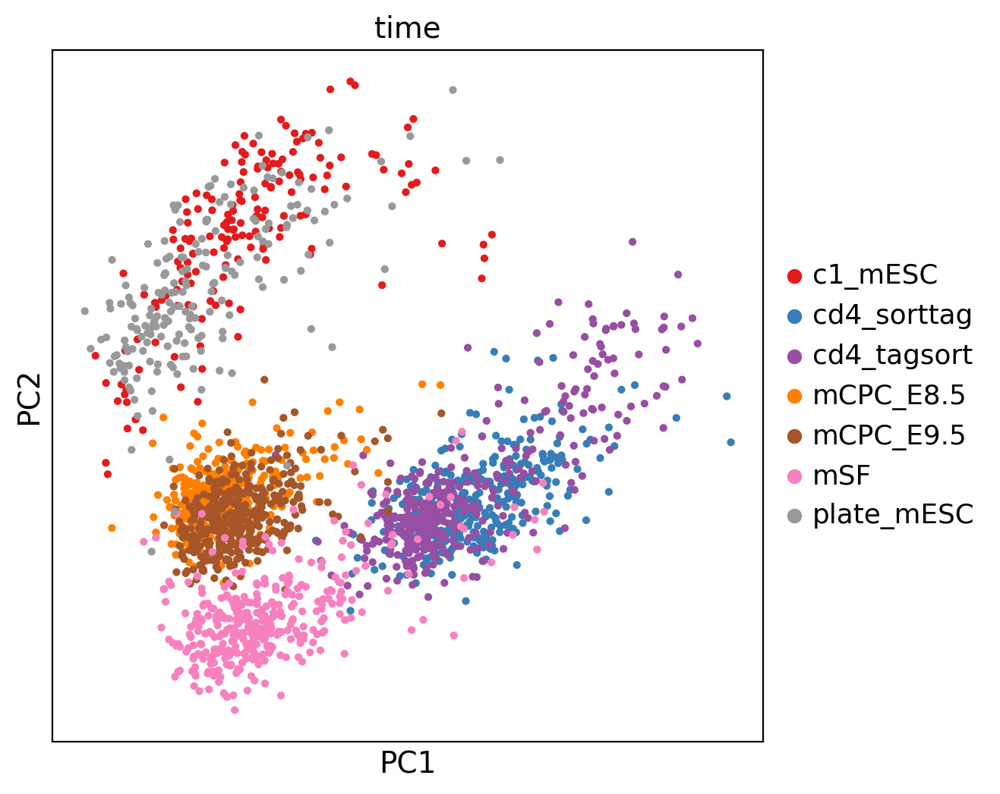

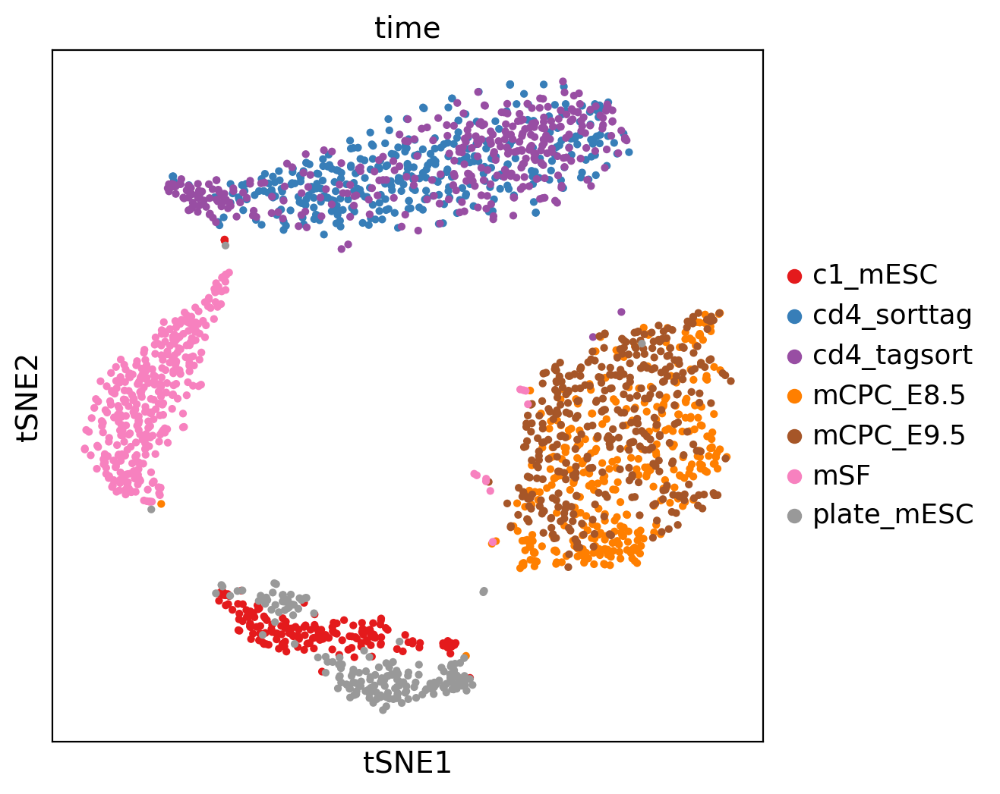

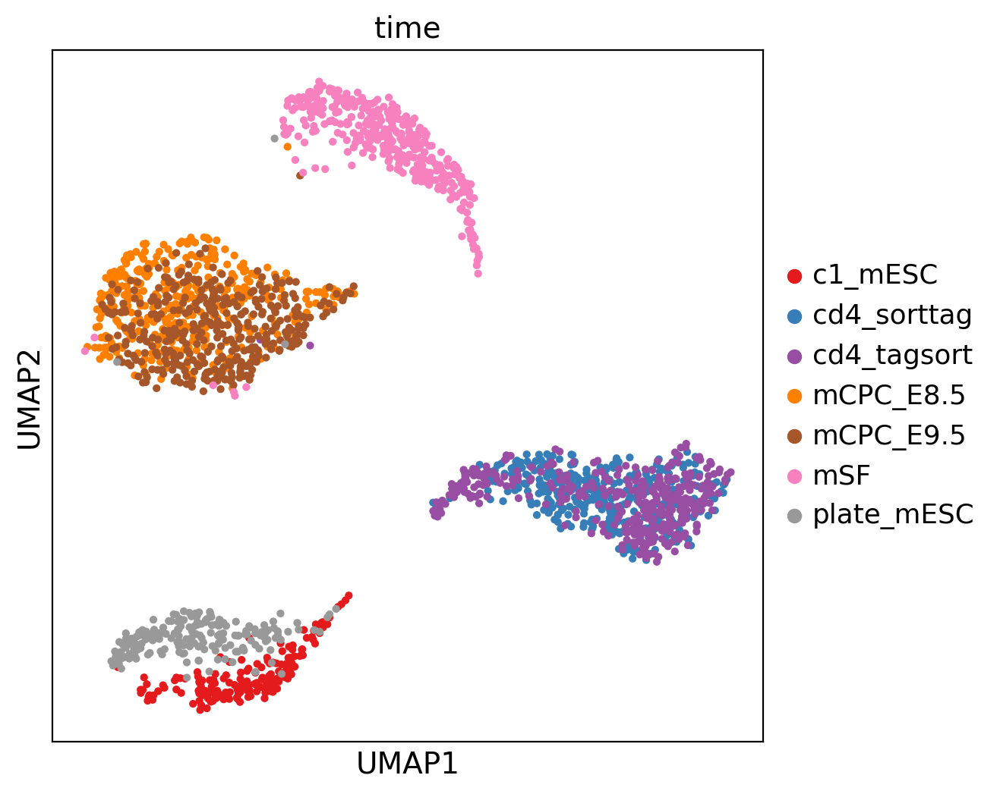

In [28]:
sc.pp.pca(adata, n_comps=20, use_highly_variable=False, svd_solver='arpack')
sc.pp.neighbors(adata)

sc.tl.tsne(adata, n_jobs=20)
sc.tl.umap(adata)

plt.rcParams['figure.figsize']=(6,6) 
sc.pl.pca(adata,color=['time'])
sc.pl.tsne(adata,color=['time'])
sc.pl.umap(adata,color=['time'])

In [26]:
adata = sc.read('write/scATAC.XC.cellLine.h5ad')

Only considering the two last: ['.cellLine', '.h5ad'].
Only considering the two last: ['.cellLine', '.h5ad'].


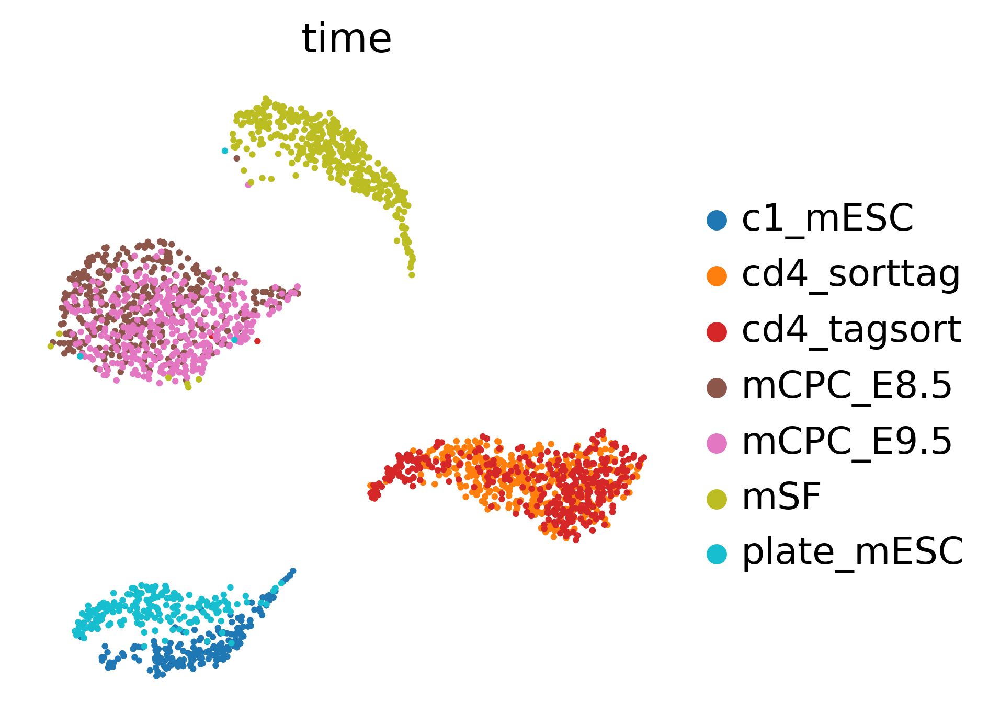

In [29]:
sc.set_figure_params(dpi=200, dpi_save=300)
plt.rcParams['figure.figsize']=(4,4) 
sc.pl.umap(adata,color=['time'], frameon=False, save='.sample.pdf',size=20, palette='tab10')

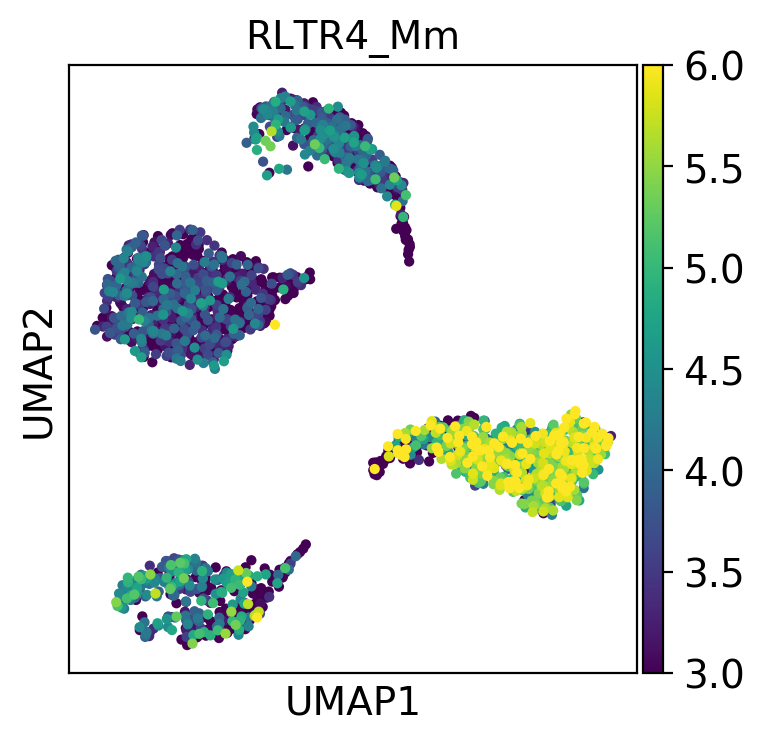

In [38]:
sc.set_figure_params(dpi=100, dpi_save=300)
sc.pl.umap(adata,color=['RLTR4_Mm'],frameon=True,vmin=3,vmax=6,save='.RLTR4_Mm.pdf')

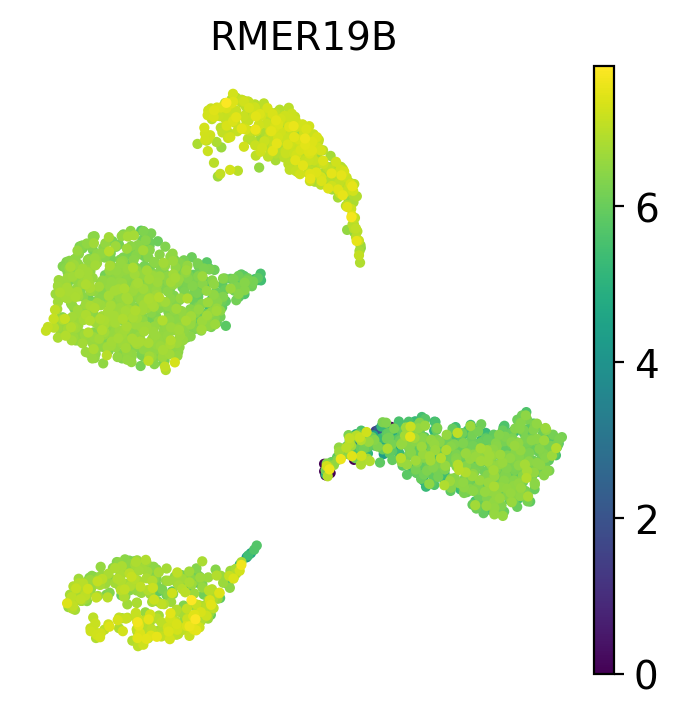

In [36]:
sc.pl.umap(adata,color=['RMER19B'],frameon=False)

In [59]:
adata.obs.head()
cd4 = [k for k in adata.obs.index if adata.obs['leiden_r0.2'][k] in ['1']]
cd4 =[k for k in cells if 'cd4' in k]
len(cd4)

other =  [k for k in adata.obs.index if adata.obs['leiden_r0.2'][k] not in ['1']]
other[:5]

filt = cd4+other
filt = adata[filt,]

In [64]:
filt

AnnData object with n_obs × n_vars = 2200 × 1077 
    obs: 'batch', 'n_genes', 'time', 'n_counts', 'log_counts', 'size_factors', 'leiden_r1', 'leiden_r0.2', 'leiden_r0.1'
    var: 'n_cells', 'highly_variable', 'means', 'dispersions', 'dispersions_norm'
    uns: 'pca', 'neighbors', 'diffmap_evals', 'time_colors', 'leiden', 'leiden_r1_colors', 'leiden_r0.2_colors', 'leiden_r0.1_colors', 'rank_genes_groups'
    obsm: 'X_pca', 'X_tsne', 'X_umap', 'X_diffmap'
    varm: 'PCs'
    layers: 'counts'

In [ ]:
sc.pp.pca(filt, n_comps=20, use_highly_variable=False, svd_solver='arpack')
sc.pp.neighbors(filt)

sc.tl.tsne(filt, n_jobs=20)
sc.tl.umap(filt)

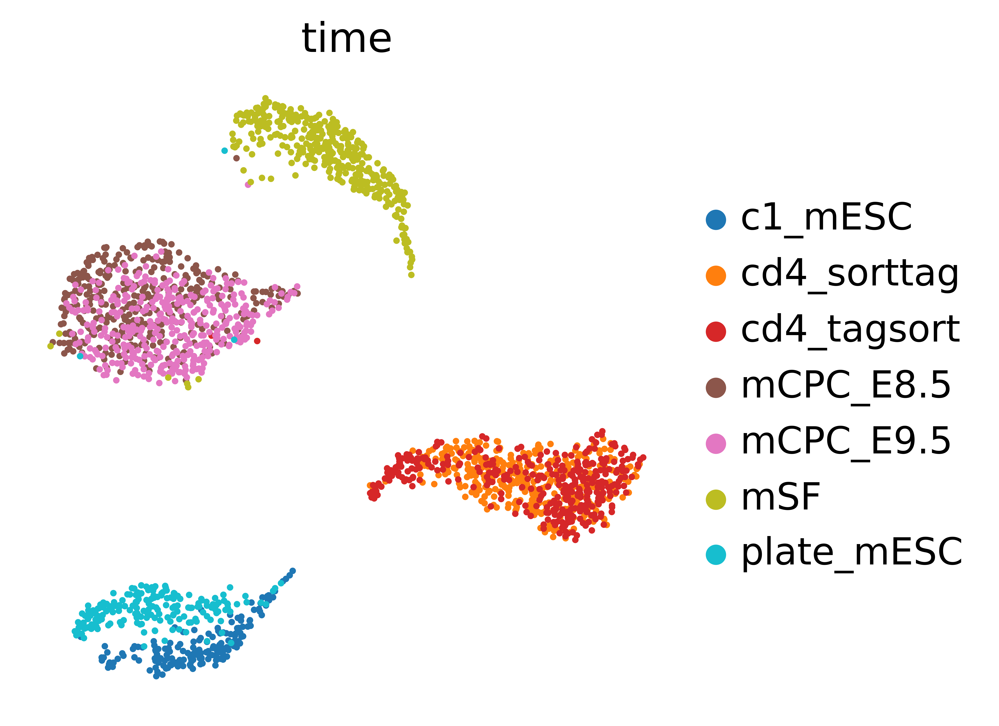

In [71]:
sc.pl.umap(filt,color=['time'],frameon=False,size=20, palette='tab10',save='.sample.pdf')

In [72]:
adata = filt.copy()

In [73]:
sc.tl.leiden(adata, key_added='leiden_r1')
sc.tl.leiden(adata, resolution=0.2, key_added='leiden_r0.2')
sc.tl.leiden(adata, resolution=0.1, key_added='leiden_r0.1')

running Leiden clustering
    finished (0:00:00)
running Leiden clustering
    finished (0:00:00)
running Leiden clustering
    finished (0:00:00)


In [74]:
sc.pl.umap(adata,color=['time','leiden_r1','leiden_r0.2','leiden_r0.1'],save='.time.leiden.pdf', palette='Set1', frameon=False)

In [75]:
adata.obs.to_csv('write/obs.csv',sep=',')
adata.write('write/scATAC.XC.cellLine.h5ad')
adata

AnnData object with n_obs × n_vars = 2200 × 1077 
    obs: 'batch', 'n_genes', 'time', 'n_counts', 'log_counts', 'size_factors', 'leiden_r1', 'leiden_r0.2', 'leiden_r0.1'
    var: 'n_cells', 'highly_variable', 'means', 'dispersions', 'dispersions_norm'
    uns: 'pca', 'neighbors', 'diffmap_evals', 'time_colors', 'leiden', 'leiden_r1_colors', 'leiden_r0.2_colors', 'leiden_r0.1_colors', 'rank_genes_groups'
    obsm: 'X_pca', 'X_tsne', 'X_umap', 'X_diffmap'
    varm: 'PCs'
    layers: 'counts'

In [76]:
sc.tl.rank_genes_groups(adata,'leiden_r0.2', n_genes=100, method='t-test')

df=pd.DataFrame( {group + '_' + key[:1]: adata.uns['rank_genes_groups'][key][group]  for group in  set(adata.obs['leiden_r0.2']) for key in ['names','logfoldchanges']})
df.to_csv('write/rank.leiden_r0.2.tsv',sep='\t')

df.head(20)

ranking genes
    finished (0:00:00)


,0_n,0_l,3_n,3_l,1_n,1_l,2_n,2_l
0,RLTR13A,5.281073,B2_Mm1a,1.202646,RLTR50A,4.569948,L1Md_T,2.807370
1,RLTR13A2,4.260161,B2_Mm2,0.878230,ORR1E,0.448558,RLTR13G,5.457630
2,RLTR13A3,3.969293,MER121,3.823424,IAPLTR1_Mm,1.426963,L1Md_Gf,4.153882
3,RLTR13A1,3.868643,B2_Mm1t,0.880688,IAPLTR3-int,2.117711,RLTR13D6,5.978274
4,RMER17A-int,2.880003,RMER15,0.810978,RLTR14,1.175180,RLTR9E,5.503422
5,RLTR1C,2.777154,L1MB7,1.015533,IAPLTR4,2.343032,RLTR13E,5.212727
6,RLTR1D,3.093708,MIR,0.477679,RLTR3_Mm,3.745035,RLTR9D,5.240212
7,RLTR50B,3.172423,RMER19B,1.124454,ORR1D2,0.460677,RLTR17,3.573662
8,LTR80B,3.772473,B3,0.527655,IAPLTR2_Mm,0.874625,MMERVK9C_I-int,3.301128
9,Plat_L3,2.507509,B3A,0.501868,RLTR4_Mm,2.229169,L1Md_A,2.199827


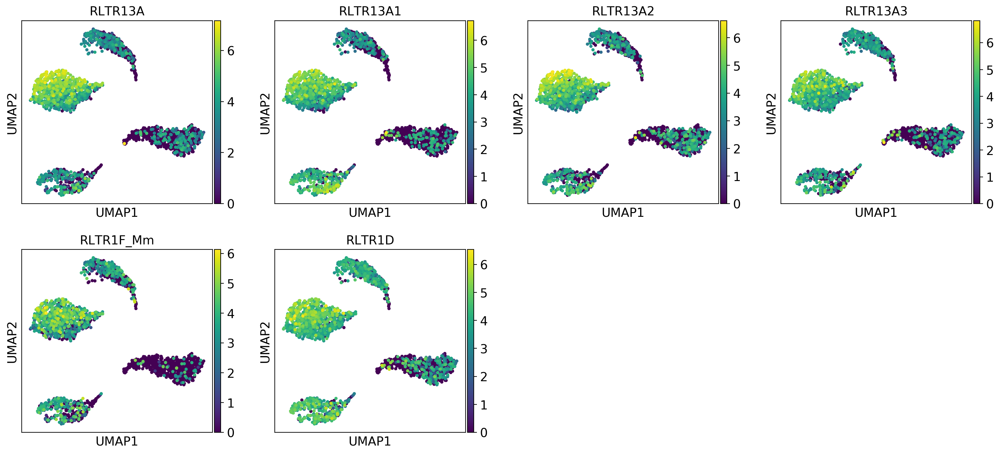

In [39]:
plt.rcParams['figure.figsize']=(4,4) 
sc.pl.umap(adata,color=['RLTR13A','RLTR13A1','RLTR13A2','RLTR13A3','RLTR1F_Mm','RLTR1D'],save='CPC.TEs.pdf', frameon=True)

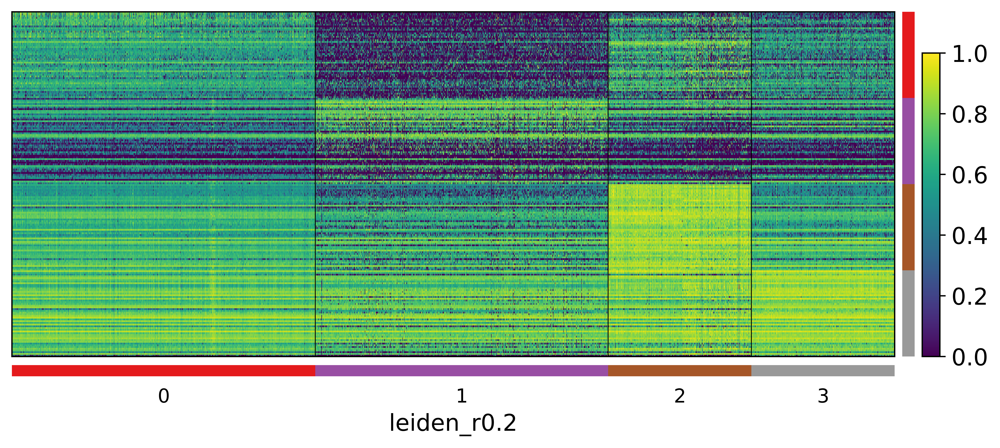

In [77]:
sc.pl.rank_genes_groups_heatmap(adata,n_genes=50,swap_axes=True, use_raw=False, standard_scale='var',dendrogram=False)

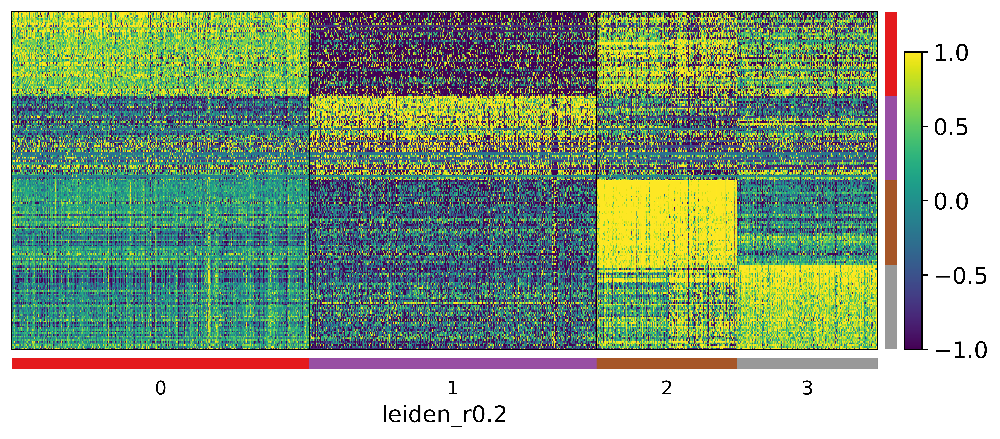

In [78]:
adataz=adata.copy()
sc.pp.scale(adataz)
sc.pl.rank_genes_groups_heatmap(adataz,n_genes=50,swap_axes=True, use_raw=False,dendrogram=False,vmax=1,vmin=-1, save='.zscore.pdf')

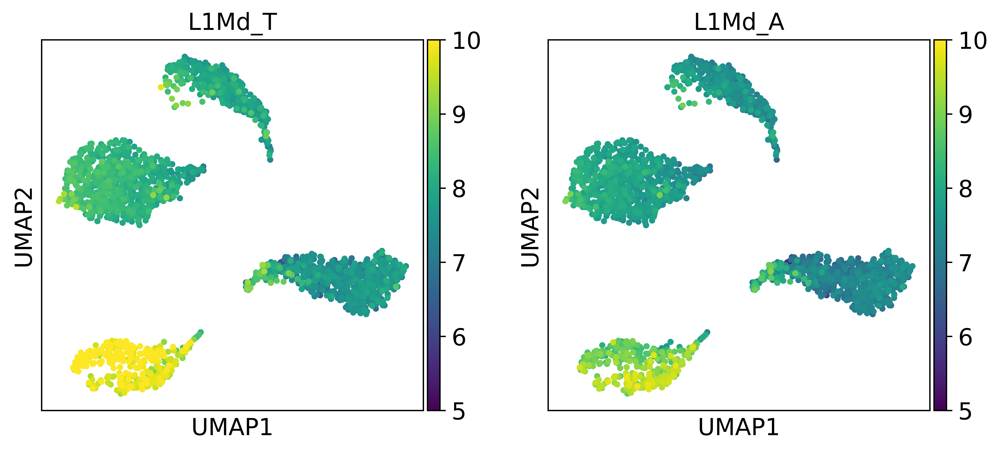

In [86]:
sc.pl.umap(adata, color =['RLTR13G','RLTR9E','RLTR9D',], save='.ESC.pdf', vmin=4, vmax=8)
sc.pl.umap(adata, color =['L1Md_T','L1Md_A'], save='.L1Md.pdf',vmin=5, vmax=10)

In [83]:
sc.pl.umap(adata, color =['RLTR13A','RLTR13A1','RLTR13A2','RLTR13A3'], save='.CPC.pdf',vmin=2, vmax=6)

In [90]:
sc.pl.umap(adata, color =['IAPLTR2_Mm','IAPLTR1_Mm','IAPLTR4','RMER6B','MER95'])

In [89]:
sc.pl.umap(adata, color =['RMER19B','RMER19C','MER121','MER125','RMER15'])